# Installing Detectron2 Dependencies

Remember to restart the Runtime after the dependencies are installed.

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
ERROR: Could not find a version that satisfies the requirement torch==1.5 (from versions: 1.11.0, 1.12.0, 1.12.1, 1.13.0, 1.13.1, 2.0.0, 2.0.1)
ERROR: No matching distribution found for torch==1.5
  Using cached PyYAML-5.1.tar.gz (274 kB)
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-7t9lk9m6
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-

In [ ]:
# Cloning the detectron2 library from github

!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-8my_4vqu
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-8my_4vqu
  Resolved https://github.com/facebookresearch/detectron2.git to commit 1a4df4d954089534daebbd7a0a45f08ece87056e
  Preparing metadata (setup.py) ... done
  Using cached pycocotools-2.0.7-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (426 kB)
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


In [ ]:
# Restart runtime prior to this
# Basic setup for running 
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# importing common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# importing utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [ ]:
# Now download the dataset to the colab environment.
# Roboflow.com has been used to store the dataset and to import it
!curl -L "https://app.roboflow.com/ds/NQJDvuGn3Z?key=c2G6whVKmV" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   892  100   892    0     0   2287      0 --:--:-- --:--:-- --:--:--  2293
100  190M  100  190M    0     0  93.6M      0  0:00:02  0:00:02 --:--:--  148M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/_annotations.coco.json  
 extracting: test/image0022_jpg.rf.79345514e4eef230048401d29e772a49.jpg  
 extracting: test/image0023_jpg.rf.86f16fd5ec00e6e8d88614f73858f0d8.jpg  
 extracting: test/image0039_jpg.rf.a8373997f6df9ef1f7cd5e83a413a7f0.jpg  
 extracting: test/image0050_jpg.rf.67a917b2c6e81fdbe9c276c5a686fc1c.jpg  
 extracting: test/image0073_jpg.rf.d2a9b447ce4ef683d994e6b3a59a4f83.jpg  
 extracting: test/image0081_jpg.rf.f0a164b7bdd935165c80de7ad156a025.jpg  
 extracting: test/image0088_jpg.rf.d6d687d9f0c60902864328a349a766e9.jpg  
 extr

In [ ]:
# registering the data instances
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [09/26 19:55:03 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/26 19:55:03 d2.data.datasets.coco]: Loaded 2139 images in COCO format from /content/train/_annotations.coco.json


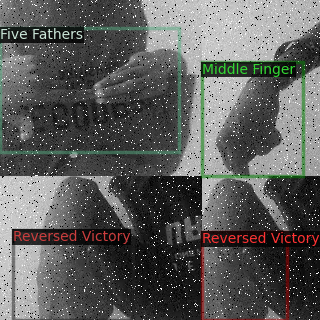

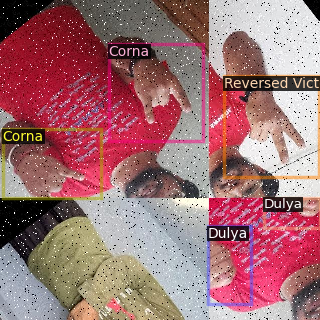

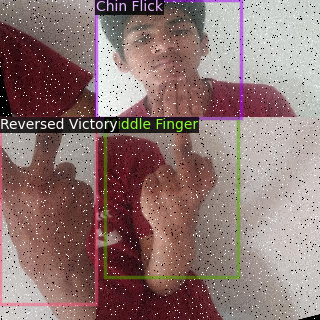

In [ ]:
#visualizing training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
# COCO evaluater is being used to run evaluations

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:


from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 6
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_101_FPN_3x.yaml") 
cfg.SOLVER.IMS_PER_BATCH = 6
cfg.SOLVER.BASE_LR = 0.009


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 3500 
cfg.SOLVER.STEPS = (2700, 3100)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11 
cfg.MODEL.RETINANET.NUM_CLASSES = 11

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[09/26 19:56:16 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_971ab9.pkl: 228MB [00:02, 113MB/s]                           
head.cls_score.{bias, weight}
  pixel_mean
  pixel_std


[09/26 19:56:19 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[09/26 19:56:59 d2.utils.events]:  eta: 1:18:04  iter: 19  total_loss: 2.284  loss_cls: 1.519  loss_box_reg: 0.7692    time: 1.5688  last_time: 1.2052  data_time: 0.0755  last_data_time: 0.0416   lr: 0.00017983  max_mem: 5050M
[09/26 19:57:31 d2.utils.events]:  eta: 1:18:50  iter: 39  total_loss: 1.645  loss_cls: 1.161  loss_box_reg: 0.5107    time: 1.4971  last_time: 1.4079  data_time: 0.0486  last_data_time: 0.0348   lr: 0.00035965  max_mem: 5050M
[09/26 19:57:57 d2.utils.events]:  eta: 1:18:53  iter: 59  total_loss: 1.45  loss_cls: 0.9789  loss_box_reg: 0.4435    time: 1.4412  last_time: 1.4288  data_time: 0.0421  last_data_time: 0.0567   lr: 0.00053947  max_mem: 5050M
[09/26 19:58:25 d2.utils.events]:  eta: 1:19:11  iter: 79  total_loss: 1.221  loss_cls: 0.8092  loss_box_reg: 0.3777    time: 1.4297  last_time: 1.1747  data_time: 0.0456  last_data_time: 0.0323   lr: 0.00071929  max_mem: 5050M
[09/26 19:58:53 d2.utils.events]:  eta: 1:18:57  iter: 99  total_loss: 1.026  loss_cls: 0.6

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 20:08:30 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0079 s/iter. Inference: 0.1083 s/iter. Eval: 0.0012 s/iter. Total: 0.1173 s/iter. ETA=0:00:32
[09/26 20:08:35 d2.evaluation.evaluator]: Inference done 56/291. Dataloading: 0.0066 s/iter. Inference: 0.1047 s/iter. Eval: 0.0005 s/iter. Total: 0.1120 s/iter. ETA=0:00:26
[09/26 20:08:40 d2.evaluation.evaluator]: Inference done 104/291. Dataloading: 0.0043 s/iter. Inference: 0.1039 s/iter. Eval: 0.0004 s/iter. Total: 0.1087 s/iter. ETA=0:00:20
[09/26 20:08:45 d2.evaluation.evaluator]: Inference done 151/291. Dataloading: 0.0041 s/iter. Inference: 0.1036 s/iter. Eval: 0.0004 s/iter. Total: 0.1082 s/iter. ETA=0:00:15
[09/26 20:08:50 d2.evaluation.evaluator]: Inference done 197/291. Dataloading: 0.0044 s/iter. Inference: 0.1035 s/iter. Eval: 0.0004 s/iter. Total: 0.1085 s/iter. ETA=0:00:10
[09/26 20:08:55 d2.evaluation.evaluator]: Inference done 245/291. Dataloading: 0.0040 s/iter. Inference: 0.1034 s/iter. Eval: 0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 20:21:07 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0011 s/iter. Inference: 0.1038 s/iter. Eval: 0.0003 s/iter. Total: 0.1053 s/iter. ETA=0:00:29
[09/26 20:21:12 d2.evaluation.evaluator]: Inference done 59/291. Dataloading: 0.0017 s/iter. Inference: 0.1029 s/iter. Eval: 0.0003 s/iter. Total: 0.1050 s/iter. ETA=0:00:24
[09/26 20:21:17 d2.evaluation.evaluator]: Inference done 105/291. Dataloading: 0.0041 s/iter. Inference: 0.1030 s/iter. Eval: 0.0003 s/iter. Total: 0.1075 s/iter. ETA=0:00:19
[09/26 20:21:22 d2.evaluation.evaluator]: Inference done 153/291. Dataloading: 0.0035 s/iter. Inference: 0.1030 s/iter. Eval: 0.0003 s/iter. Total: 0.1070 s/iter. ETA=0:00:14
[09/26 20:21:27 d2.evaluation.evaluator]: Inference done 201/291. Dataloading: 0.0033 s/iter. Inference: 0.1029 s/iter. Eval: 0.0003 s/iter. Total: 0.1067 s/iter. ETA=0:00:09
[09/26 20:21:32 d2.evaluation.evaluator]: Inference done 246/291. Dataloading: 0.0040 s/iter. Inference: 0.1031 s/iter. Eval: 0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 20:33:44 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0012 s/iter. Inference: 0.1039 s/iter. Eval: 0.0003 s/iter. Total: 0.1054 s/iter. ETA=0:00:29
[09/26 20:33:50 d2.evaluation.evaluator]: Inference done 59/291. Dataloading: 0.0018 s/iter. Inference: 0.1030 s/iter. Eval: 0.0003 s/iter. Total: 0.1052 s/iter. ETA=0:00:24
[09/26 20:33:55 d2.evaluation.evaluator]: Inference done 105/291. Dataloading: 0.0031 s/iter. Inference: 0.1037 s/iter. Eval: 0.0003 s/iter. Total: 0.1073 s/iter. ETA=0:00:19
[09/26 20:34:00 d2.evaluation.evaluator]: Inference done 151/291. Dataloading: 0.0040 s/iter. Inference: 0.1039 s/iter. Eval: 0.0003 s/iter. Total: 0.1083 s/iter. ETA=0:00:15
[09/26 20:34:05 d2.evaluation.evaluator]: Inference done 199/291. Dataloading: 0.0035 s/iter. Inference: 0.1036 s/iter. Eval: 0.0003 s/iter. Total: 0.1075 s/iter. ETA=0:00:09
[09/26 20:34:10 d2.evaluation.evaluator]: Inference done 246/291. Dataloading: 0.0034 s/iter. Inference: 0.1035 s/iter. Eval: 0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 20:46:22 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0006 s/iter. Inference: 0.1041 s/iter. Eval: 0.0003 s/iter. Total: 0.1049 s/iter. ETA=0:00:29
[09/26 20:46:27 d2.evaluation.evaluator]: Inference done 56/291. Dataloading: 0.0067 s/iter. Inference: 0.1041 s/iter. Eval: 0.0003 s/iter. Total: 0.1113 s/iter. ETA=0:00:26
[09/26 20:46:33 d2.evaluation.evaluator]: Inference done 101/291. Dataloading: 0.0047 s/iter. Inference: 0.1067 s/iter. Eval: 0.0003 s/iter. Total: 0.1118 s/iter. ETA=0:00:21
[09/26 20:46:38 d2.evaluation.evaluator]: Inference done 147/291. Dataloading: 0.0046 s/iter. Inference: 0.1061 s/iter. Eval: 0.0004 s/iter. Total: 0.1111 s/iter. ETA=0:00:15
[09/26 20:46:43 d2.evaluation.evaluator]: Inference done 193/291. Dataloading: 0.0047 s/iter. Inference: 0.1055 s/iter. Eval: 0.0003 s/iter. Total: 0.1106 s/iter. ETA=0:00:10
[09/26 20:46:48 d2.evaluation.evaluator]: Inference done 241/291. Dataloading: 0.0042 s/iter. Inference: 0.1049 s/iter. Eval: 0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 20:59:01 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0011 s/iter. Inference: 0.1038 s/iter. Eval: 0.0003 s/iter. Total: 0.1051 s/iter. ETA=0:00:29
[09/26 20:59:06 d2.evaluation.evaluator]: Inference done 57/291. Dataloading: 0.0052 s/iter. Inference: 0.1035 s/iter. Eval: 0.0003 s/iter. Total: 0.1091 s/iter. ETA=0:00:25
[09/26 20:59:11 d2.evaluation.evaluator]: Inference done 104/291. Dataloading: 0.0043 s/iter. Inference: 0.1032 s/iter. Eval: 0.0003 s/iter. Total: 0.1079 s/iter. ETA=0:00:20
[09/26 20:59:16 d2.evaluation.evaluator]: Inference done 150/291. Dataloading: 0.0044 s/iter. Inference: 0.1035 s/iter. Eval: 0.0003 s/iter. Total: 0.1083 s/iter. ETA=0:00:15
[09/26 20:59:21 d2.evaluation.evaluator]: Inference done 196/291. Dataloading: 0.0047 s/iter. Inference: 0.1036 s/iter. Eval: 0.0003 s/iter. Total: 0.1087 s/iter. ETA=0:00:10
[09/26 20:59:27 d2.evaluation.evaluator]: Inference done 244/291. Dataloading: 0.0043 s/iter. Inference: 0.1035 s/iter. Eval: 0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 21:11:44 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0018 s/iter. Inference: 0.1041 s/iter. Eval: 0.0003 s/iter. Total: 0.1062 s/iter. ETA=0:00:29
[09/26 21:11:49 d2.evaluation.evaluator]: Inference done 58/291. Dataloading: 0.0025 s/iter. Inference: 0.1035 s/iter. Eval: 0.0003 s/iter. Total: 0.1064 s/iter. ETA=0:00:24
[09/26 21:11:54 d2.evaluation.evaluator]: Inference done 105/291. Dataloading: 0.0027 s/iter. Inference: 0.1034 s/iter. Eval: 0.0003 s/iter. Total: 0.1065 s/iter. ETA=0:00:19
[09/26 21:11:59 d2.evaluation.evaluator]: Inference done 149/291. Dataloading: 0.0042 s/iter. Inference: 0.1043 s/iter. Eval: 0.0003 s/iter. Total: 0.1090 s/iter. ETA=0:00:15
[09/26 21:12:04 d2.evaluation.evaluator]: Inference done 197/291. Dataloading: 0.0038 s/iter. Inference: 0.1039 s/iter. Eval: 0.0003 s/iter. Total: 0.1082 s/iter. ETA=0:00:10
[09/26 21:12:09 d2.evaluation.evaluator]: Inference done 244/291. Dataloading: 0.0038 s/iter. Inference: 0.1038 s/iter. Eval: 0

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 21:24:34 d2.evaluation.evaluator]: Inference done 11/291. Dataloading: 0.0051 s/iter. Inference: 0.1034 s/iter. Eval: 0.0004 s/iter. Total: 0.1089 s/iter. ETA=0:00:30
[09/26 21:24:39 d2.evaluation.evaluator]: Inference done 58/291. Dataloading: 0.0041 s/iter. Inference: 0.1032 s/iter. Eval: 0.0003 s/iter. Total: 0.1078 s/iter. ETA=0:00:25
[09/26 21:24:44 d2.evaluation.evaluator]: Inference done 104/291. Dataloading: 0.0039 s/iter. Inference: 0.1040 s/iter. Eval: 0.0003 s/iter. Total: 0.1083 s/iter. ETA=0:00:20
[09/26 21:24:49 d2.evaluation.evaluator]: Inference done 150/291. Dataloading: 0.0041 s/iter. Inference: 0.1043 s/iter. Eval: 0.0004 s/iter. Total: 0.1089 s/iter. ETA=0:00:15
[09/26 21:24:54 d2.evaluation.evaluator]: Inference done 197/291. Dataloading: 0.0038 s/iter. Inference: 0.1043 s/iter. Eval: 0.0003 s/iter. Total: 0.1086 s/iter. ETA=0:00:10
[09/26 21:25:00 d2.evaluation.evaluator]: Inference done 244/291. Dataloading: 0.0036 s/iter. Inference: 0.1043 s/iter. Eval: 0

In [ ]:
# to download the training files and metrics
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!zip -r /content/output.zip /content/output

  adding: content/output/ (stored 0%)
  adding: content/output/model_final.pth (deflated 7%)
  adding: content/output/last_checkpoint (stored 0%)
  adding: content/output/events.out.tfevents.1694948812.bb1a0475eca3.1807.1 (deflated 73%)
  adding: content/output/instances_predictions.pth (deflated 57%)
  adding: content/output/coco_instances_results.json (deflated 69%)
  adding: content/output/.ipynb_checkpoints/ (stored 0%)
  adding: content/output/metrics.json (deflated 81%)


In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!zip -r /content/coco_eval.zip /content/coco_eval

  adding: content/coco_eval/ (stored 0%)
  adding: content/coco_eval/instances_predictions.pth (deflated 57%)
  adding: content/coco_eval/coco_instances_results.json (deflated 70%)
  adding: content/coco_eval/.ipynb_checkpoints/ (stored 0%)


In [ ]:
# tensorboard to study the data
%reload_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
#evaluation on test dataset
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[09/26 21:26:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [09/26 21:26:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [09/26 21:26:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/26 21:26:45 d2.data.datasets.coco]: Loaded 159 images in COCO format from /content/test/_annotations.coco.json
[09/26 21:26:45 d2.data.build]: Distribution of instances among all 11 categories:
|   category    | #instances   |  category  | #instances   |   category   | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:------------:|:-------------|
| Offensive-G.. | 0            | Chin Flick | 21           |    Corna     | 20           |
|     Dulya     | 23           | Fist Mouth | 20           | Five Fathers | 11           |
| Middle Fi

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/26 21:26:47 d2.evaluation.evaluator]: Inference done 11/159. Dataloading: 0.0052 s/iter. Inference: 0.1089 s/iter. Eval: 0.0004 s/iter. Total: 0.1145 s/iter. ETA=0:00:16
[09/26 21:26:53 d2.evaluation.evaluator]: Inference done 57/159. Dataloading: 0.0052 s/iter. Inference: 0.1046 s/iter. Eval: 0.0003 s/iter. Total: 0.1104 s/iter. ETA=0:00:11
[09/26 21:26:58 d2.evaluation.evaluator]: Inference done 103/159. Dataloading: 0.0044 s/iter. Inference: 0.1047 s/iter. Eval: 0.0003 s/iter. Total: 0.1096 s/iter. ETA=0:00:06
[09/26 21:27:03 d2.evaluation.evaluator]: Inference done 150/159. Dataloading: 0.0036 s/iter. Inference: 0.1049 s/iter. Eval: 0.0003 s/iter. Total: 0.1089 s/iter. ETA=0:00:00
[09/26 21:27:04 d2.evaluation.evaluator]: Total inference time: 0:00:16.997294 (0.110372 s / iter per device, on 1 devices)
[09/26 21:27:04 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:16 (0.104911 s / iter per device, on 1 devices)
[09/26 21:27:04 d2.evaluation.coco_evaluation]: 

OrderedDict([('bbox',
              {'AP': 77.46477039723072,
               'AP50': 98.83078307830783,
               'AP75': 97.5244741865491,
               'APs': nan,
               'APm': 77.09385509979569,
               'APl': 77.56353590074787,
               'AP-Offensive-Gestures': nan,
               'AP-Chin Flick': 82.00812388931202,
               'AP-Corna': 74.17116711671167,
               'AP-Dulya': 75.98531592289665,
               'AP-Fist Mouth': 66.73048300305142,
               'AP-Five Fathers': 80.004500450045,
               'AP-Middle Finger': 79.5872045005012,
               'AP-Moutza': 85.08034586264056,
               'AP-Okay': 79.60761467451094,
               'AP-Reversed Victory': 74.07498312856495,
               'AP-Thumbs Up': 77.39796542407278})])

# Inference with Detectron2 Saved Weights



In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
%ls /content/output

coco_instances_results.json                         last_checkpoint
events.out.tfevents.1695758222.f85b172b862e.3060.0  metrics.json
instances_predictions.pth                           model_final.pth


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.9  
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[09/26 21:30:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


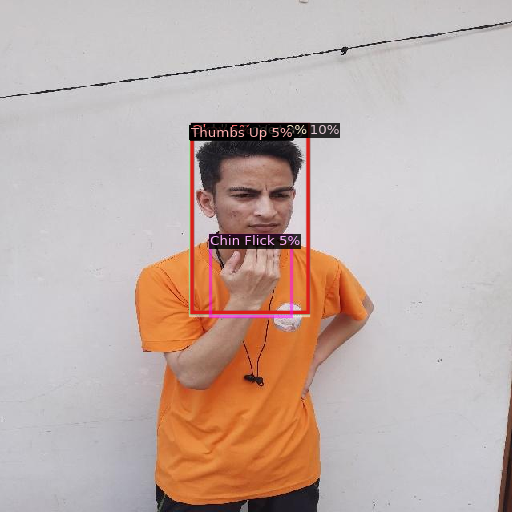

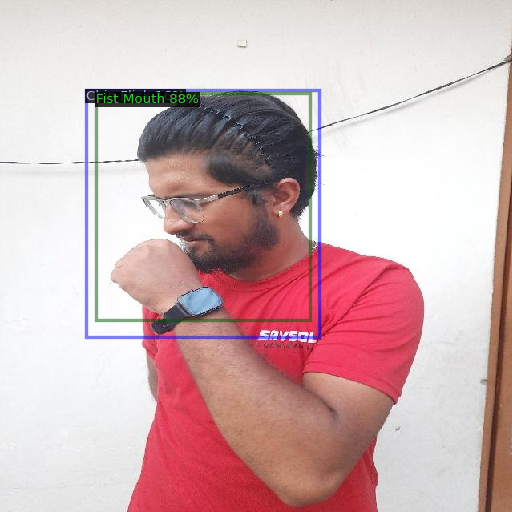

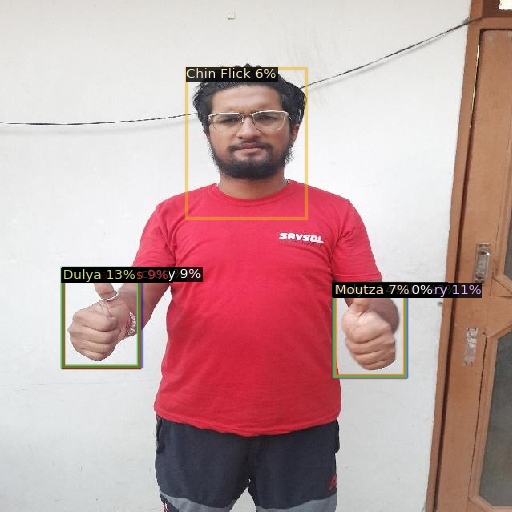

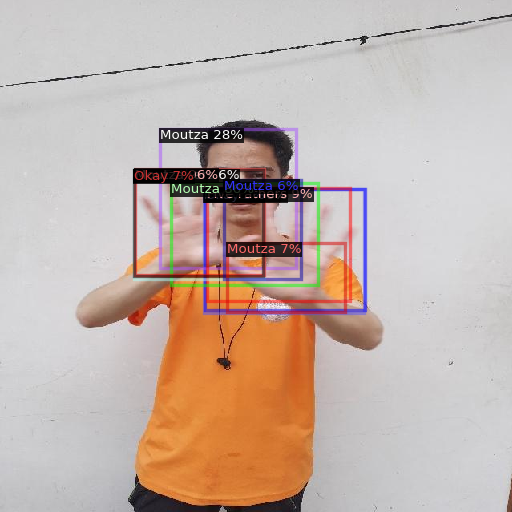

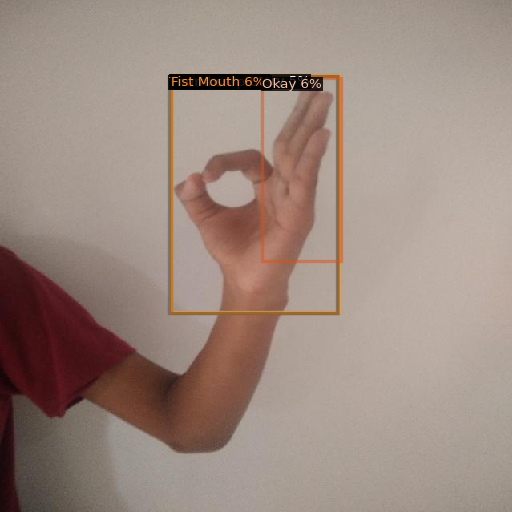

...

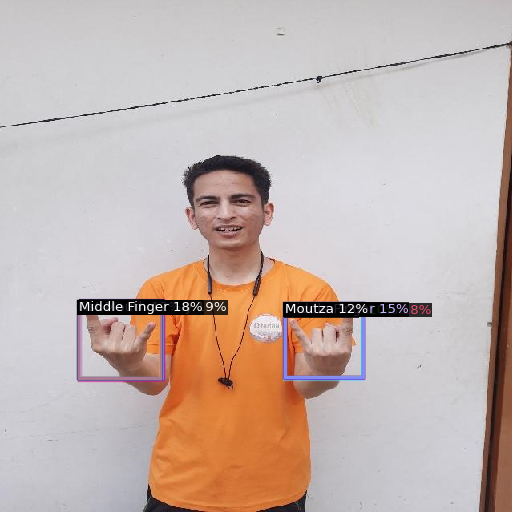

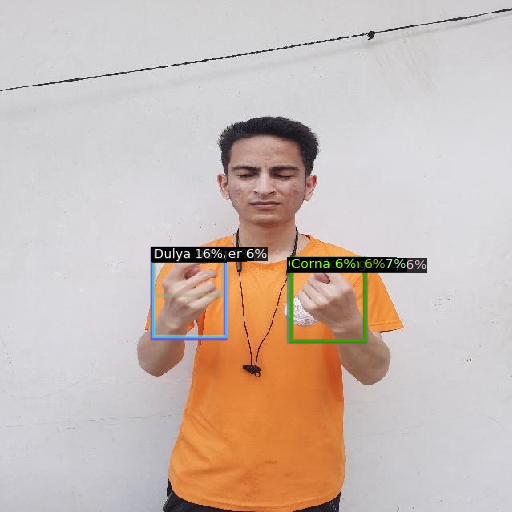

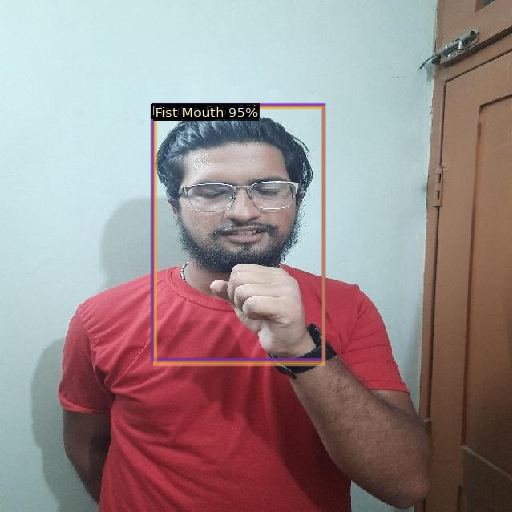

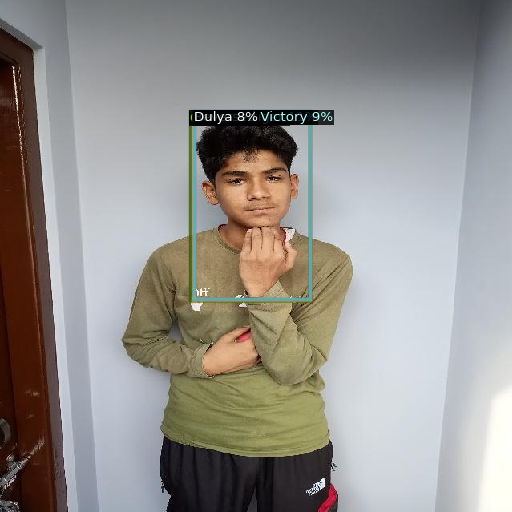

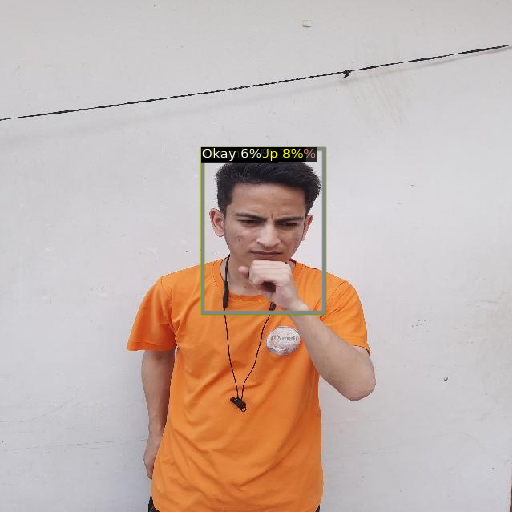

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
